# Python Convolutional Neural Networks

O sistema deve reconhecer áreas de talhões (unidade mínima de cultivo de uma propriedade) em um mapa, utilizando dados multitemporais, através de inteligência artificial, a interface gráfica (Web GIS), deve permitir ao usuário selecionar um intervalo de tempo e as imagens de um catálogo disponível para a região selecionada, carregando-as em bloco para não sobrecarregar o sistema e ter opção para download.

Web GIS (Web Geographic Information System): Portal de um “Sistema de Informação Geográfica” (SIG), baseado em padrão de serviços web OGC, fornecendo uma estrutura para visualização e navegação de mapas (basemaps) e de dados geográficos vetoriais e matriciais.

- Catálogo de Imagem: O Catálogo de Imagem deve possibilitar a catalogação de coleções de dados espaço-temporal, (metadados) dos satélites Landsat 8 e Sentinel-2. Obs: O catálogo de imagem também deverá fornecer interface (web API) que permitirá consultar e recuperar as cenas de satélite catalogadas. Esta interface possibilitará que o Web GIS realize pesquisas complexas, filtrando diferentes parâmetros e especificando critérios geográficos.

- Map Tile Engine: Esse componente deve produzir “map raster tile” para uma determinada cena de satélite, obedecendo ao padrão OGC WMTS. Permitindo que
usuários do Web GIS visualizem e naveguem pelas imagens sem precisar baixá-las (real time streaming). Cada map tile é uma representação visual de parte da imagem, não dos dados em si. Esses tiles geralmente são renderizados em formato pictórico (PNG ou JPEG) que podem ser exibidos em uma aplicação web.

- Download: Após a consulta às imagens de uma determinada área de interesse, o sistema permite o download de todas as cenas (com todas as suas bandas) do período selecionado pelo usuário (Pilha de imagem).

- Máscara (Mask): Neste módulo, o sistema gerará uma máscara binária com as regiões de interesse (AOI’s) para cada cena selecionada. A construção das máscaras de saída das áreas de interesse, se dão apresentando valor igual a um (1) dentro desse poligono, enquanto as demais áreas (áreas não selecionadas) apresentam valor igual a zero (0).


<p align = "center">
  <img width = "600px" src = "./docs/assets/example.png">
</p>

- Arquivo: Após a geração da máscara para cada cena (scene), é preciso armazená-la tanto para validação visual quanto para download. Com isso, nesse módulo a máscara deve ser armazenada de alguma forma que possibilite ao usuário fazer sua validação visual (próxima etapa), assim como o download para treinamento de modelos de inteligência artificial.

> Funcionamento das redes neurais convolucionais para o processamento das imagens.

**Obs.:** Instalação do Miniconda é necessária para a execução dos comandos a seguir.

### Ambiente de Desenvolvimento
```
# Montar no ambiente Linux
$ sudo apt-get update
$ sudo apt-get install python-numpy gdal-bin libgdal-dev

# Crie um novo ambiente conda com Python3+
$ conda create --name python-cnn python=3.6.9

# Ativar o ambiente
$ conda activate python-cnn

# Com o ambiente ativado instalar o ipykernel
(python-cnn) $ conda install notebook ipykernel

# Com o ipykernel criar um kernel com o python 3.5 automático
(python-cnn) $ ipython kernel install --user --name python-cnn

# Instalar o servidor Jupyter Lab
(python-cnn) $ python -m pip install jupyter

# Instalar a biblioteca gdal e basemap para processar as imagens
(python-cnn) $ conda install -c conda-forge gdal=2.4.4 decartes

# Executar o servidor em modo de desenvolvimento
(python-cnn) $ jupyter notebook
```

> **Obs.:** Pode ser que o Notebook não  reconheça o kernel instalado pelo conda, sendo assim você pode alterar manualmente `kernel >> Change Kernel >> python-cnn`.

### Ambiente de micro serviços em docker
```
# Construir a imagem Docker
$ docker build -t jupyter-python-cnn .

# Executar a imagem
$ docker run --name jupyter-python-cnn-docker -p 8890:8888 -d jupyter-python-cnn
```

### Código fonte

> Também será necessário acesso ao servidores FTP:

- [Sentinel-1 Data](http://www.dpi.inpe.br/agricultural-database/lem/dados/cenas/Sentinel1);

- [Sentinel-2 Data](http://www.dpi.inpe.br/obt/agricultural-database/lem/dados/cenas/Sentinel2);

- [Landsat-8 Data](http://www.dpi.inpe.br/obt/agricultural-database/lem/dados/cenas/Landsat8);

> Para a execução do código fonte abaixo é necessário o download da pasta [`data/`](https://fatecspgov-my.sharepoint.com/:f:/g/personal/abner_anjos_fatec_sp_gov_br/EqcawzIRy5VBhi7LqlXGtpgB-DHpZq5IG1DspKuwD59YBA?e=4LEDNC), após o download descompacte na pasta root do projeto.


```
data/
    |_ input/
        |_ train/
            |_ false/
            |_ true/
        |_ validation/
            |_ br_uf/
            |_ false/
            |_ LEM_shapes/
            |_ true/
    |_ output/
```

In [1]:
# !pip install tensorflow numpy matplotlib pillow wget rasterio geopandas

In [2]:
import tensorflow as tf

In [3]:
from tensorflow.keras.models import Sequential
from tensorflow.keras.layers import Dense, Conv2D, Flatten, Dropout, MaxPooling2D
from tensorflow.keras.preprocessing.image import ImageDataGenerator

import numpy as np
import matplotlib.pyplot as plt

In [4]:
# Abstração das buscas por polígonos e georasters
from services.georasters import Georaster
from services.vector import Vector

In [9]:
data = Georaster('2017-06-12 08h:35m:46s','vh', 4326)

In [6]:
data.openRemoteFile()

True

In [7]:
data.projection

'EPSG:4326'

In [8]:
data.downloadRemoteFile()

True

In [9]:
data.convertFileToJPG()

True

In [10]:
data.georaster.read(1)

array([[nan, nan, nan, ..., nan, nan, nan],
       [nan, nan, nan, ..., nan, nan, nan],
       [nan, nan, nan, ..., nan, nan, nan],
       ...,
       [nan, nan, nan, ..., nan, nan, nan],
       [nan, nan, nan, ..., nan, nan, nan],
       [nan, nan, nan, ..., nan, nan, nan]], dtype=float32)

In [11]:
data.jpg

In [12]:
for coords in data.geom.get('coordinates'):
    for coord in coords:
        print(data.georaster.read(1)[int(coord[1])][int(coord[0])])

-18.735785
-19.409836
-20.503849
-17.980326
-18.735785


In [13]:
shapes = Vector(4326)

In [ ]:
data.geom

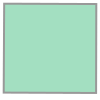

In [22]:
data_geom = shapes.shape(data.geom.get('coordinates')[0])
data_geom

In [21]:
data.geom

{'type': 'Polygon',
 'coordinates': [[[-46.422421, -11.831513],
   [-46.426524, -12.598503],
   [-45.629512, -12.601568],
   [-45.627701, -11.834385],
   [-46.422421, -11.831513]]]}

In [15]:
shapes.lem.head(5)

,NM_MUNICIP,CD_GEOCMU,geometry
0,LUÃS EDUARDO MAGALHÃES,2919553,"POLYGON ((-45.71038 -12.39706, -45.71422 -12.3..."


In [16]:
shapes.covers.head(5)

,Id,area_ha,Jun_2017,Jul_2017,Aug_2017,Sep_2017,Oct_2017,Nov_2017,Dec_2017,Jan_2018,Feb_2018,Mar_2018,Apr_2018,May_2018,Jun_2018,Geral,variacao,var,geometry
0,1,341.632515,uncultivated soil,uncultivated soil,uncultivated soil,uncultivated soil,uncultivated soil,uncultivated soil,uncultivated soil,soybean,soybean,soybean,uncultivated soil,uncultivated soil,uncultivated soil,xxxxxxxsssxxx,xsx,s,"POLYGON ((391870.392 8678209.011, 390327.395 8..."
1,523,148.290258,millet,millet,uncultivated soil,uncultivated soil,uncultivated soil,not identified,uncultivated soil,not identified,not identified,uncultivated soil,millet,millet,uncultivated soil,llxxx-x--xllx,lxlx,ll,"POLYGON ((362953.448 8648254.537, 362492.885 8..."
2,3,196.784309,uncultivated soil,uncultivated soil,uncultivated soil,uncultivated soil,uncultivated soil,uncultivated soil,uncultivated soil,soybean,soybean,soybean,uncultivated soil,uncultivated soil,uncultivated soil,xxxxxxxsssxxx,xsx,s,"POLYGON ((394667.970 8677930.309, 394381.632 8..."
3,524,28.625248,sorghum,sorghum,sorghum,uncultivated soil,uncultivated soil,uncultivated soil,uncultivated soil,soybean,soybean,soybean,uncultivated soil,uncultivated soil,uncultivated soil,zzzxxxxsssxxx,zxsx,zs,"POLYGON ((378784.772 8650768.854, 378340.528 8..."
4,6,369.452478,uncultivated soil,uncultivated soil,uncultivated soil,uncultivated soil,uncultivated soil,uncultivated soil,uncultivated soil,uncultivated soil,soybean,soybean,uncultivated soil,uncultivated soil,uncultivated soil,xxxxxxxxssxxx,xsx,s,"POLYGON ((398795.097 8680743.662, 398796.144 8..."


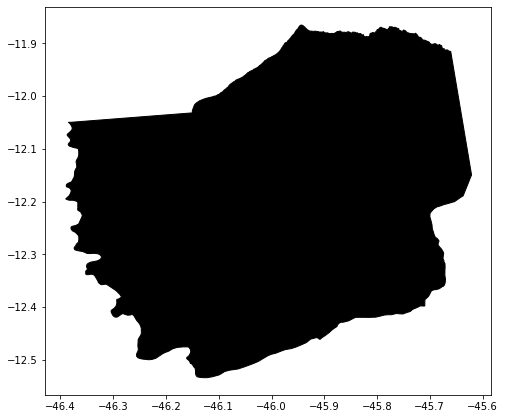

In [17]:
shapes.lem.plot(color = 'black', edgecolor = 'black', figsize = (8, 8))

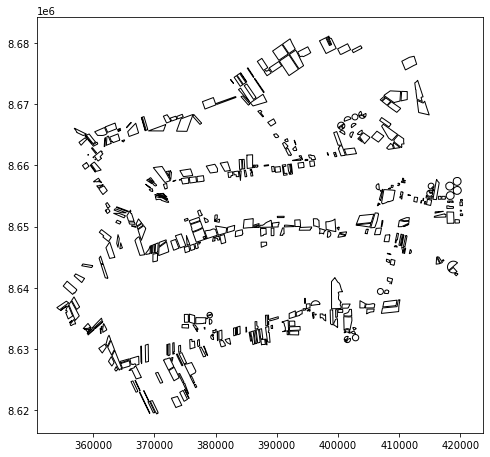

In [18]:
shapes.covers.plot(color = 'white', edgecolor = 'black', figsize = (8, 8))

In [10]:
!ls -l data/input/train/true

total 1696536
-rw-r--r-- 1 abner abner 117589085 jun  4  2018 image10.tif
-rw-r--r-- 1 abner abner  58825766 jun  4  2018 image11.tif
-rw-r--r-- 1 abner abner 228341788 mai 14 11:18 image1.tif
-rw-rw-r-- 1 abner abner 231710599 mai 27 07:59 image2.tif
-rw-r--r-- 1 abner abner 228918854 mai 11 17:15 image3.tif
-rw-rw-r-- 1 abner abner 231557786 mai 11 10:27 image4.tif
-rw-rw-r-- 1 abner abner 228275958 mai 11 10:27 image5.tif
-rw-r--r-- 1 abner abner 117743705 jun  4  2018 image6.tif
-rw-r--r-- 1 abner abner 117743683 jun  4  2018 image7.tif
-rw-r--r-- 1 abner abner  58903076 jun  4  2018 image8.tif
-rw-r--r-- 1 abner abner 117589063 jun  4  2018 image9.tif


In [13]:
for i in range(11):
    if data.convertAnyFileToJPG("data/input/train/true/image{}".format(i + 1)):
        print("Converted Image {}".format(i + 1))

Converted Image 1
Converted Image 2
Converted Image 3
Converted Image 4
Converted Image 5
Converted Image 6
Converted Image 7
Converted Image 8
Converted Image 9
Converted Image 10
Converted Image 11


In [14]:
!ls -l data/input/train/false

total 1608788
-rw-r--r-- 1 abner abner 117589091 jun  4  2018 image10.tif
-rw-r--r-- 1 abner abner 117589091 jun  4  2018 image11.tif
-rw-r--r-- 1 abner abner 117589091 jun  4  2018 image12.tif
-rw-r--r-- 1 abner abner 117589091 jun  4  2018 image13.tif
-rw-r--r-- 1 abner abner 117589091 jun  4  2018 image14.tif
-rw-r--r-- 1 abner abner 117743711 jun  4  2018 image1.tif
-rw-r--r-- 1 abner abner 117743711 jun  4  2018 image2.tif
-rw-r--r-- 1 abner abner 117743711 jun  4  2018 image3.tif
-rw-r--r-- 1 abner abner 117743711 jun  4  2018 image4.tif
-rw-r--r-- 1 abner abner 117743711 jun  4  2018 image5.tif
-rw-r--r-- 1 abner abner 117743711 jun  4  2018 image6.tif
-rw-r--r-- 1 abner abner 117743711 jun  4  2018 image7.tif
-rw-r--r-- 1 abner abner 117589091 jun  4  2018 image8.tif
-rw-r--r-- 1 abner abner 117589091 jun  4  2018 image9.tif


In [16]:
for i in range(14):
    if data.convertAnyFileToJPG("data/input/train/false/image{}".format(i + 1)):
        print("Converted Image {}".format(i + 1))

Converted Image 1
Converted Image 2
Converted Image 3
Converted Image 4
Converted Image 5
Converted Image 6
Converted Image 7
Converted Image 8
Converted Image 9
Converted Image 10
Converted Image 11
Converted Image 12
Converted Image 13
Converted Image 14


In [17]:
!ls -Rl data/input/train

data/input/train:
total 1130016
-rw-r--r-- 1 abner abner   8298184 mai 15 14:37 clip_20170612T083546_Sigma0_VH_db.jpg
-rw-r--r-- 1 abner abner 228341788 mai 14 11:18 clip_20170612T083546_Sigma0_VH_db.tif
-rw-rw-r-- 1 abner abner 231710599 mai 27 07:59 clip_20170612T083546_Sigma0_VV_db.tif
-rw-rw-r-- 1 abner abner 228275958 mai 11 10:27 clip_20170624T083547_Sigma0_VH_db.tif
-rw-rw-r-- 1 abner abner 231557786 mai 11 10:27 clip_20170624T083547_Sigma0_VV_db.tif
-rw-r--r-- 1 abner abner 228918854 mai 11 17:15 clip_20180315T083548_Sigma0_VH_db.tif
drwxr-xr-x 2 abner abner      4096 mai 27 11:31 false
drwxr-xr-x 2 abner abner      4096 mai 27 11:28 true

data/input/train/false:
total 856928
-rw-r--r-- 1 abner abner 835637688 mai 27 11:30 geotifs.zip
-rw-r--r-- 1 abner abner  41848673 mai 27 11:31 jpgs.zip

data/input/train/true:
total 1168760
-rw-r--r-- 1 abner abner 1151611114 mai 27 11:27 geotifs.zip
-rw-r--r-- 1 abner abner   45190244 mai 27 11:28 jpgs.zip


In [18]:
_URL = 'data/input/train/true/jpgs.zip'

path_to_zip = tf.keras.utils.get_file('images.zip', origin=_URL, extract=True)

PATH = os.path.join(os.path.dirname(path_to_zip), 'jpgs.zip')

ValueError: unknown url type: 'data/input/train/true/jpgs.zip'